In [1]:
import os
import sys
import time
import joblib
import random

import torch
import numpy as np
from tqdm import tqdm
import matplotlib.pyplot as plt

from pmc_oa.utils            import get_memory_usage
from pmc_oa.utils.json_utils import save_json,load_json


In [2]:
from pmc_oa.data_loaders.dino_features_loader import load_and_concatenate_subsets

In [3]:
data_path:str  = "/pasteur/u/ale9806/Repositories/pmc-oa/DinoFeatures"
model_path:str = "/pasteur/u/ale9806/Repositories/pmc-oa/scripts/Labeler/models"
n:int = 1900 #1900
data = load_and_concatenate_subsets(data_path,samples_per_shard=n,limit=20)
data["images"] = torch.from_numpy(data["images"])

Limit enabled only loading:
['other_0_to_100', 'other_100_to_111']
Limit enabled only loading:
['commercial_1000_to_1100', 'commercial_1500_to_1572', 'commercial_0_to_100', 'commercial_200_to_300', 'commercial_900_to_1000', 'shapes.npy', 'commercial_1100_to_1200', 'features.npy', 'keys.npy', '.ipynb_checkpoints', 'commercial_600_to_700', 'commercial_1700_to_1761', 'commercial_1200_to_1300', 'images.npy', 'commercial_100_to_200', 'commercial_1500_to_1600', 'commercial_500_to_600', 'commercial_300_to_400', 'commercial_1600_to_1700', 'commercial_400_to_500']
Limit enabled only loading:
['noncommercial_0_to_100', 'noncommercial_400_to_500', 'noncommercial_300_to_400', 'noncommercial_100_to_200', 'noncommercial_500_to_534', 'noncommercial_200_to_300']


In [4]:
pca    = joblib.load(os.path.join(model_path, "pca_1000.joblib"))
kmeans = joblib.load(os.path.join(model_path, "kmeans_1000.joblib"))
reduced_features = pca.transform(data["features"])    # Apply PCA
labels = kmeans.predict(reduced_features)             # Apply KMeans

In [5]:
indices = np.random.permutation(data["images"] .shape[0])
shuffled_images = data["images"][indices]
shuffled_labels = labels[indices]

0


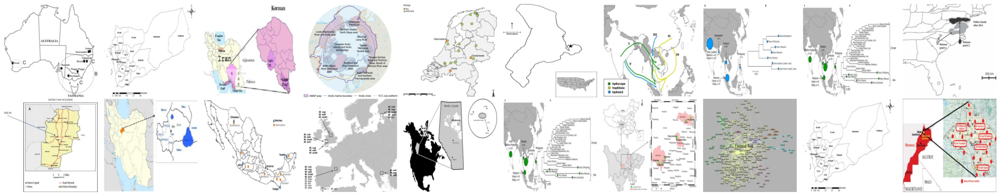

1


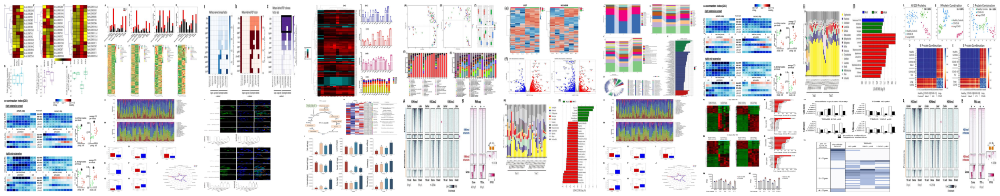

2


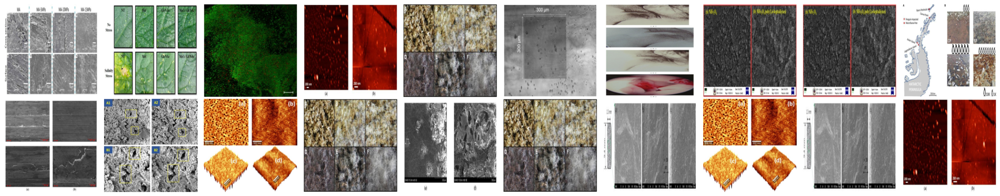

3


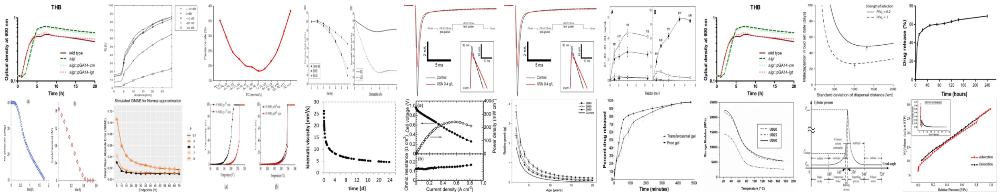

4


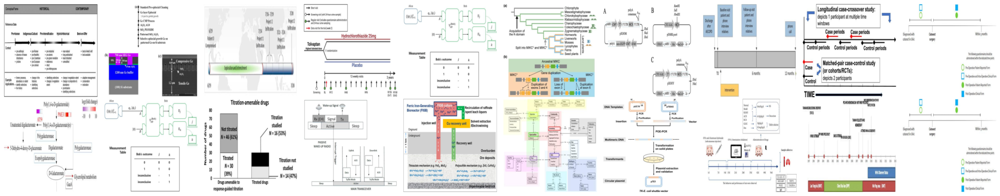

5


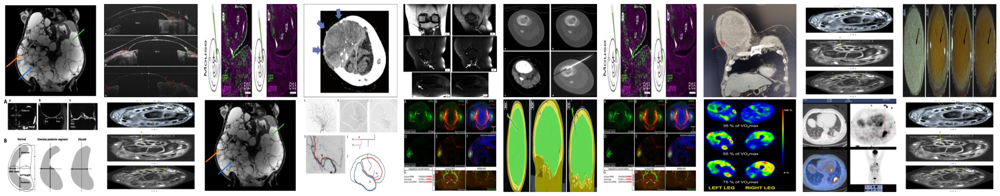

6


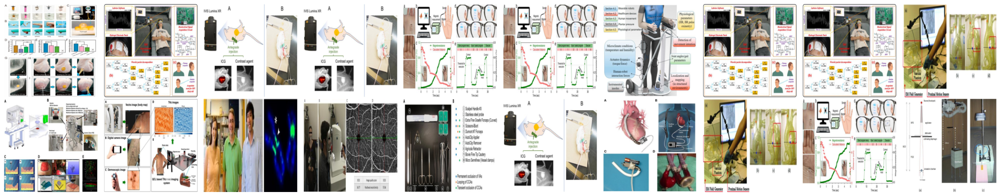

7


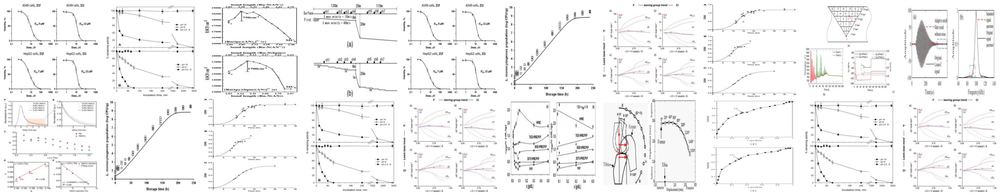

8


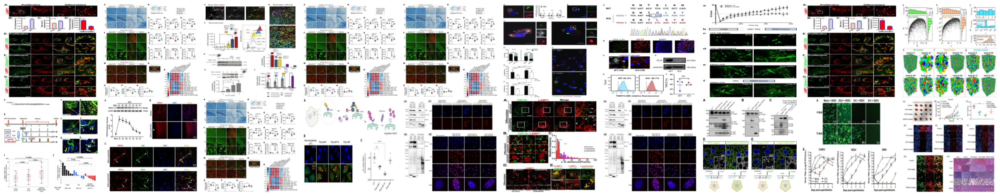

9


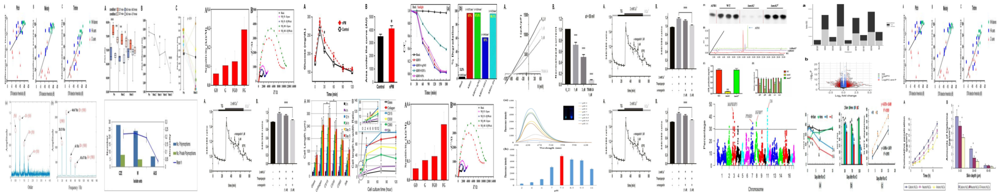

10


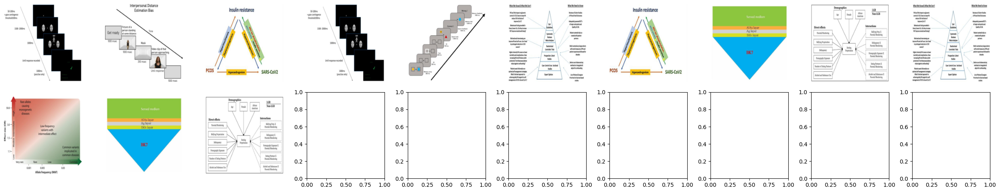

11


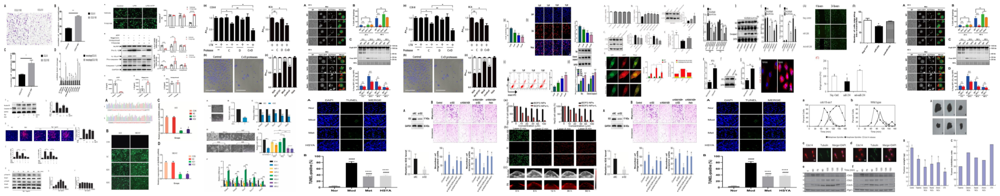

12


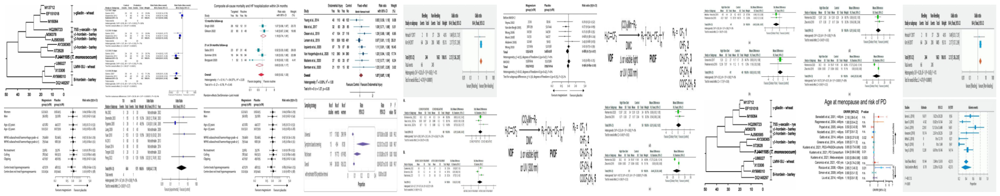

13


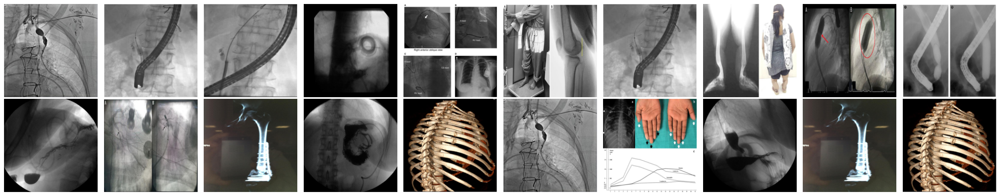

14


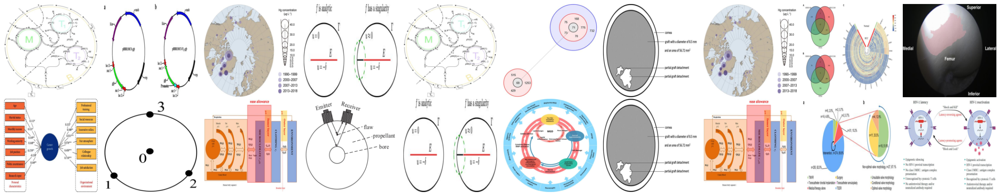

15


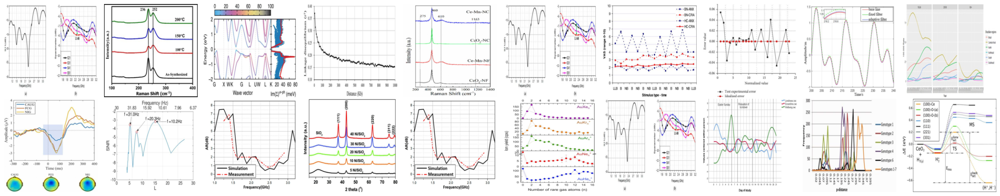

16


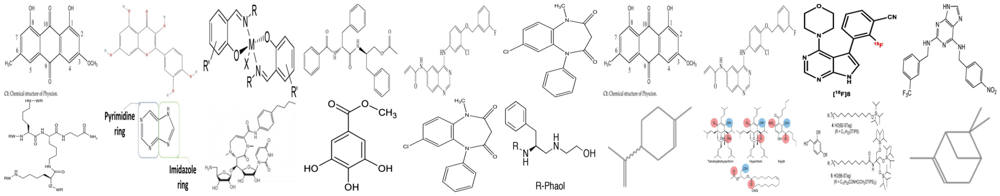

17


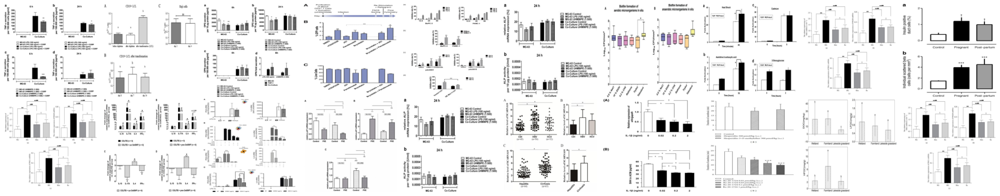

18


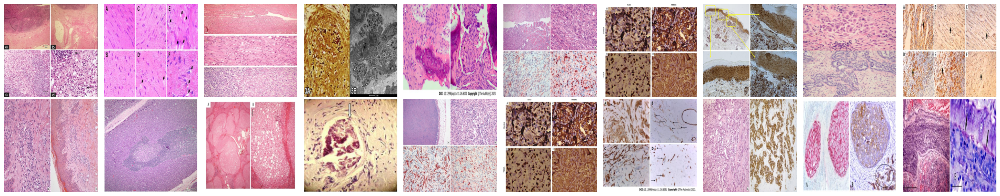

19


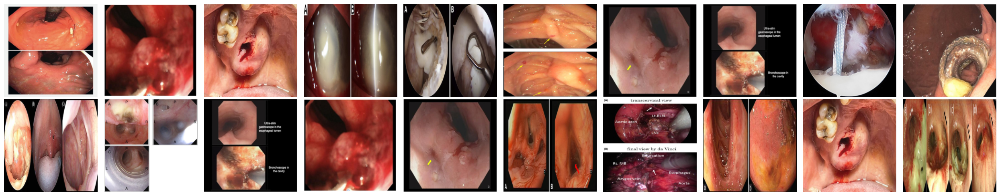

20


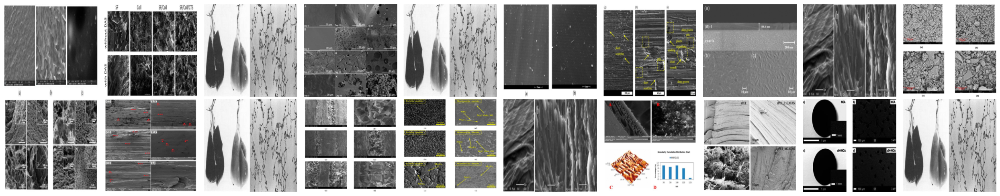

21


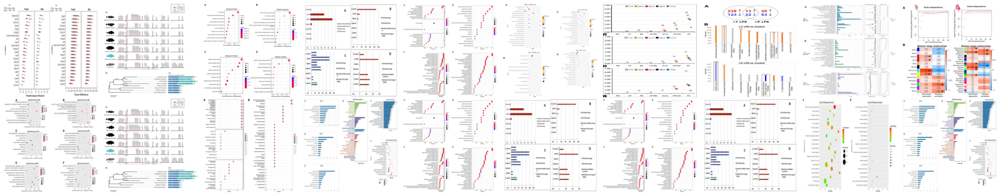

22


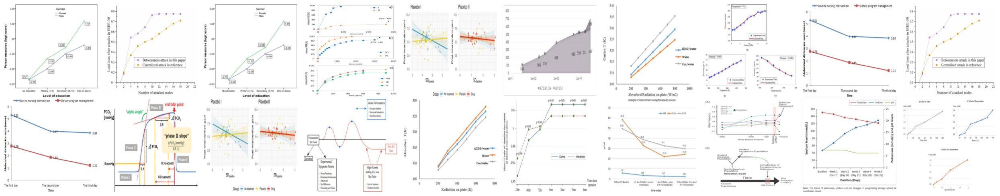

23


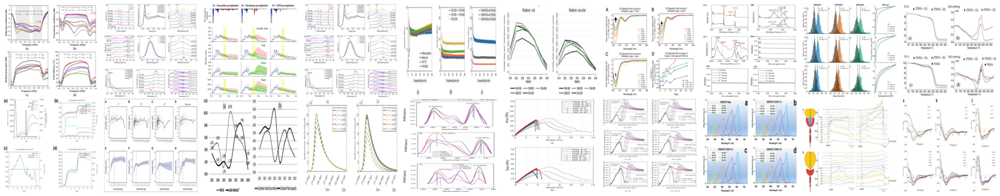

24


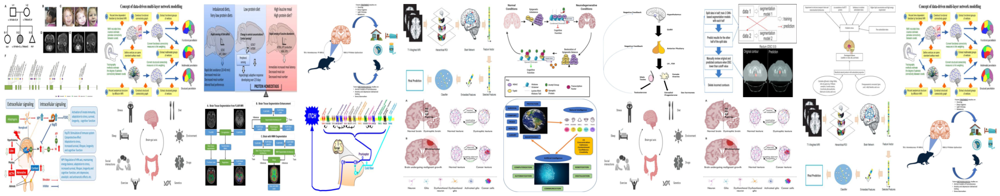

25


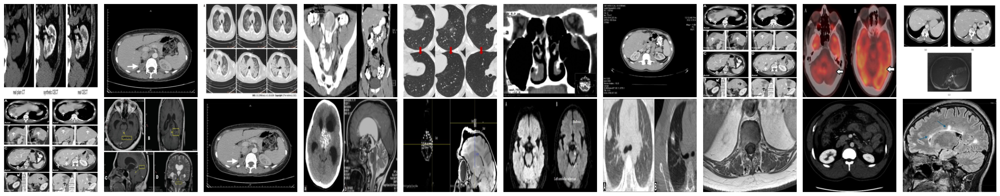

26


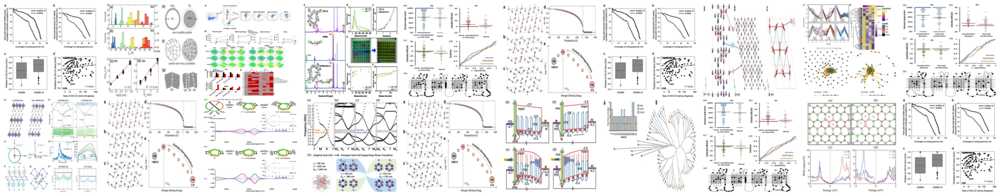

27


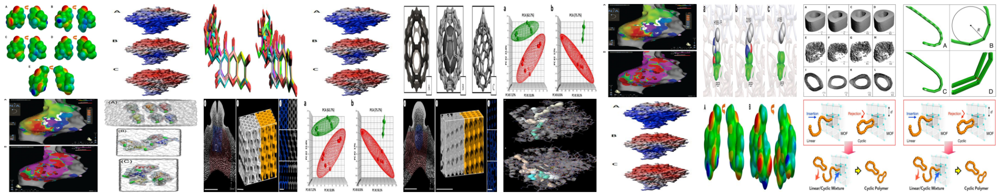

28


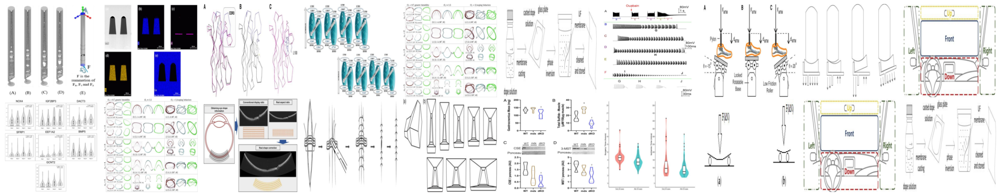

29


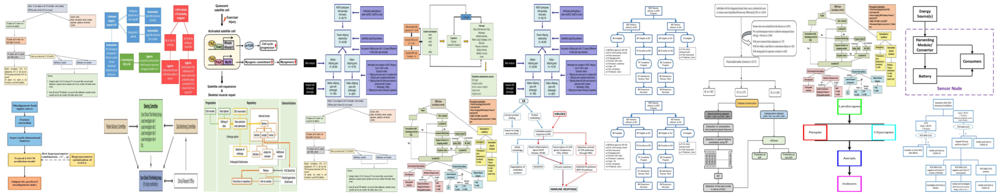

30


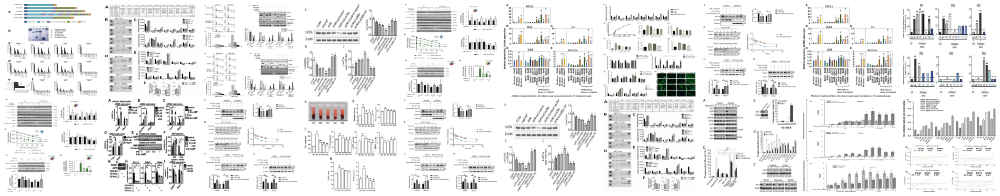

31


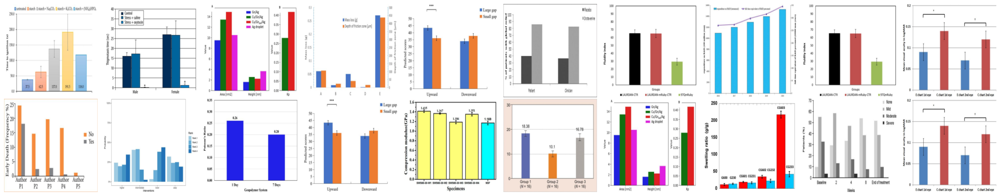

32


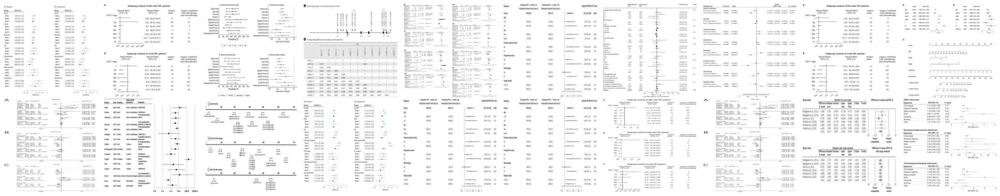

33


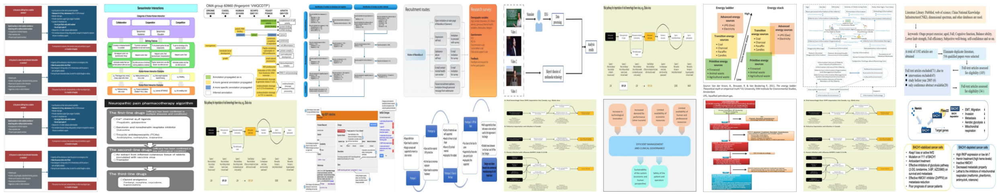

34


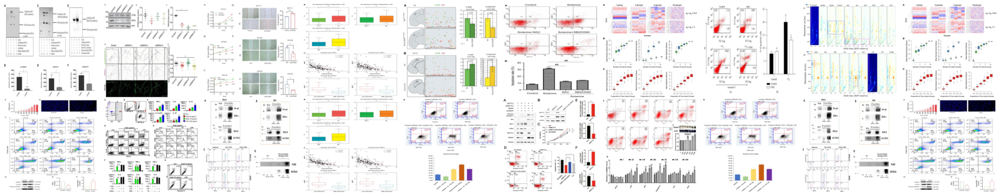

35


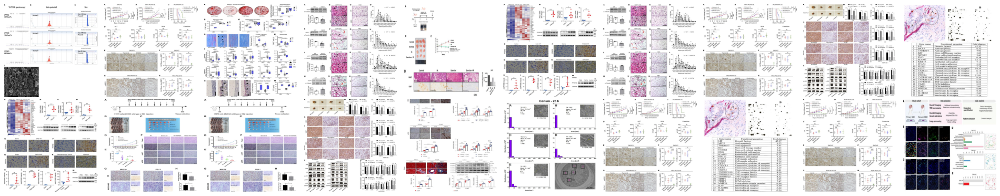

36


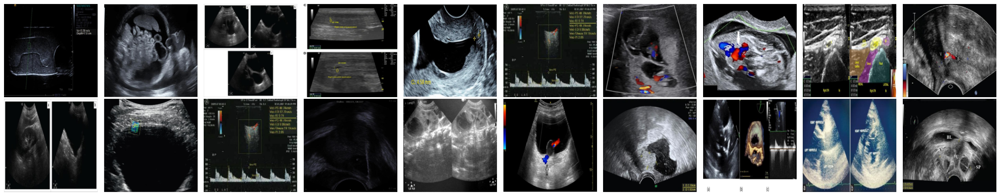

37


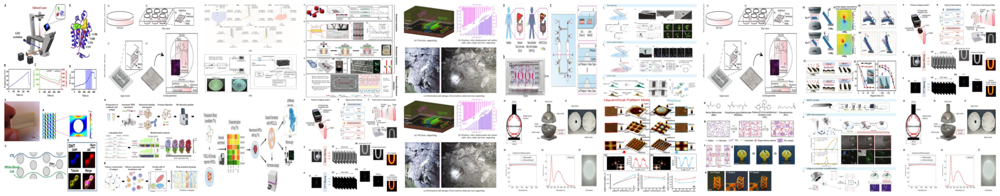

38


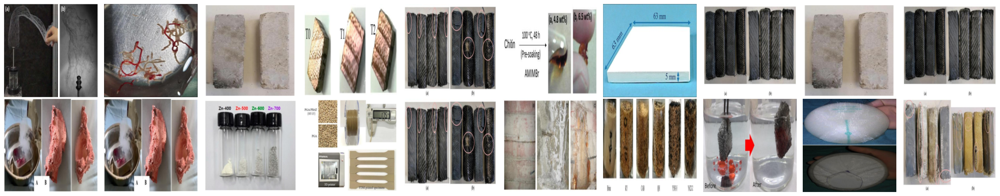

39


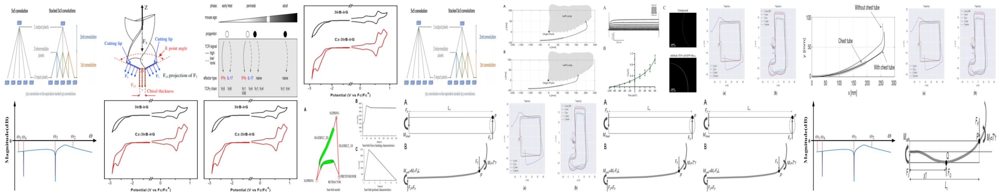

In [6]:
num_clusters = 40
# Loop through each image and label to display them
for LABEL in range(0,num_clusters):
    print("="*10)
    print(LABEL)
    print("="*10)
    j = 0
    
    fig, axes = plt.subplots(nrows=2, ncols=10, figsize=(25, 5))  # 5 rows, 10 columns
    axes      = axes.flatten()  # Flatten the 2D array of axes to easily iterate over it

    for i, _ in enumerate(shuffled_images):
        if shuffled_labels[i] == LABEL:
            ax = axes[j]
            ax.imshow(shuffled_images [i].permute(1,2,0))  # Change from (C, H, W) to (H, W, C)
            #ax.imshow(images[i].reshape(224, 224, 3))
            #ax.set_title(labels[i])
            ax.axis('off')  # Turn off axis
            j +=1
        if j == 20:
            break
            
    
    # Adjust layout
    plt.tight_layout()
    plt.show()

In [ ]:
import os
from tqdm import tqdm  #
import matplotlib.pyplot as plt

def save_clustered_images(path, shuffled_images, shuffled_labels):
    # Create the main directory if it doesn't exist
    num_clusters = len(np.unique(shuffled_labels))
    os.makedirs(path, exist_ok=True)

    # Loop through each label to display and save images
    for LABEL in tqdm(range(num_clusters), desc="Processing Clusters"):

        # Create a directory for the current label
        label_dir = os.path.join(path, f'label_{LABEL}')
        os.makedirs(label_dir, exist_ok=True)

        j = 0
        fig, axes = plt.subplots(nrows=2, ncols=10, figsize=(25, 5))  # 2 rows, 10 columns
        axes = axes.flatten()  # Flatten the 2D array of axes to easily iterate over it

         # Get indices of images with the current label
        indices = np.where(shuffled_labels == LABEL)[0]
        
        # Limit to 20 images for the current label
        if len(indices) > 20:
            indices = indices[:20]

        # Create a figure to display the images
        j = len(indices)
        fig, axes = plt.subplots(nrows=2, ncols=10, figsize=(25, 5))  # 2 rows, 10 columns
        axes = axes.flatten()  # Flatten the 2D array of axes to easily iterate over it

        for j, idx in enumerate(indices):
            ax = axes[j]
            ax.imshow(shuffled_images[idx].permute(1, 2, 0))  # Change from (C, H, W) to (H, W, C)
            ax.axis('off')  # Turn off axis

        # Turn off remaining axes if less than 20 images
        for ax in axes[j:]:
            ax.axis('off')

        # Adjust layout
        plt.tight_layout()
        
        # Save the figure to the directory for the current label
        plt.savefig(os.path.join(label_dir, f'cluster_{LABEL}.png'))
        plt.close(fig)  # Close the figure to free memory
        plt.clf()  # Clear the current figure to avoid warnings


# Example usage:
save_clustered_images('/pasteur/u/ale9806/Repositories/pmc-oa/taxonomy_examples', shuffled_images, shuffled_labels)


Processing Clusters:   2%|█▍                                                                           | 19/999 [00:15<12:37,  1.29it/s]/tmp/ale9806/ipykernel_2603683/4105646332.py:30: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = plt.subplots(nrows=2, ncols=10, figsize=(25, 5))  # 2 rows, 10 columns
Processing Clusters:   2%|█▌                                                                           | 20/999 [00:16<12:33,  1.30it/s]/tmp/ale9806/ipykernel_2603683/4105646332.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the